In [1]:
import numpy as np
import pandas as pd

In [2]:
df = pd.read_csv('complaints.csv', low_memory=False)

In [3]:
df.head()

,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
0,2024-01-24,Credit reporting or other personal consumer re...,Credit reporting,Incorrect information on your report,Account information incorrect,NaN,Company has responded to the consumer and the ...,"TRANSUNION INTERMEDIATE HOLDINGS, INC.",FL,33578,NaN,Consent not provided,Web,2024-01-24,Closed with explanation,Yes,NaN,8205544
1,2024-02-26,Credit reporting or other personal consumer re...,Credit reporting,Incorrect information on your report,Information belongs to someone else,NaN,Company believes it acted appropriately as aut...,"CCS Financial Services, Inc.",NC,27536,NaN,Consent not provided,Web,2024-02-26,Closed with non-monetary relief,Yes,NaN,8423775
2,2024-01-26,Credit reporting or other personal consumer re...,Credit reporting,Incorrect information on your report,Information belongs to someone else,"The companies, along with the credit reporting...",NaN,"EQUIFAX, INC.",NC,28804,NaN,Consent provided,Web,2024-01-26,Closed with non-monetary relief,Yes,NaN,8232435
3,2024-01-26,Credit reporting or other personal consumer re...,Credit reporting,Improper use of your report,Reporting company used your report improperly,In accordance with the Fair Credit Reporting a...,NaN,"EQUIFAX, INC.",GA,30213,NaN,Consent provided,Web,2024-01-26,Closed with explanation,Yes,NaN,8231458
4,2024-01-18,Credit reporting or other personal consumer re...,Credit reporting,Incorrect information on your report,Account information incorrect,XXXX XXXX XXXX XXXX XXXX XXXX XXXX - XXXX Acco...,Company has responded to the consumer and the ...,"TRANSUNION INTERMEDIATE HOLDINGS, INC.",TX,752XX,NaN,Consent provided,Web,2024-01-18,Closed with non-monetary relief,Yes,NaN,8179637


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5157101 entries, 0 to 5157100
Data columns (total 18 columns):
 #   Column                        Dtype 
---  ------                        ----- 
 0   Date received                 object
 1   Product                       object
 2   Sub-product                   object
 3   Issue                         object
 4   Sub-issue                     object
 5   Consumer complaint narrative  object
 6   Company public response       object
 7   Company                       object
 8   State                         object
 9   ZIP code                      object
 10  Tags                          object
 11  Consumer consent provided?    object
 12  Submitted via                 object
 13  Date sent to company          object
 14  Company response to consumer  object
 15  Timely response?              object
 16  Consumer disputed?            object
 17  Complaint ID                  int64 
dtypes: int64(1), object(17)
memory usage: 708.

In [5]:
df.shape

(5157101, 18)

In [6]:
df.isnull().sum()

Date received                         0
Product                               0
Sub-product                      235292
Issue                                 2
Sub-issue                        734976
Consumer complaint narrative    3344052
Company public response         2685701
Company                               0
State                             45571
ZIP code                          30225
Tags                            4674703
Consumer consent provided?      1024775
Submitted via                         0
Date sent to company                  0
Company response to consumer         14
Timely response?                      0
Consumer disputed?              4388785
Complaint ID                          0
dtype: int64

In [7]:
df.columns

Index(['Date received', 'Product', 'Sub-product', 'Issue', 'Sub-issue',
       'Consumer complaint narrative', 'Company public response', 'Company',
       'State', 'ZIP code', 'Tags', 'Consumer consent provided?',
       'Submitted via', 'Date sent to company', 'Company response to consumer',
       'Timely response?', 'Consumer disputed?', 'Complaint ID'],
      dtype='object')

In [8]:
df[['Date received', 'Date sent to company']] = df[['Date received', 'Date sent to company']].apply(pd.to_datetime)

In [9]:
df['ZIP code']

0          33578
1          27536
2          28804
3          30213
4          752XX
           ...  
5157096    76036
5157097    08046
5157098    77316
5157099    30013
5157100    75057
Name: ZIP code, Length: 5157101, dtype: object

In [10]:
df.rename(columns = {'Consumer consent provided?':'Consumer consent provided', 'Timely response?':'Timely response',
                     'Consumer disputed?':'Consumer disputed'}, inplace = True)

In [11]:
df.columns

Index(['Date received', 'Product', 'Sub-product', 'Issue', 'Sub-issue',
       'Consumer complaint narrative', 'Company public response', 'Company',
       'State', 'ZIP code', 'Tags', 'Consumer consent provided',
       'Submitted via', 'Date sent to company', 'Company response to consumer',
       'Timely response', 'Consumer disputed', 'Complaint ID'],
      dtype='object')

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5157101 entries, 0 to 5157100
Data columns (total 18 columns):
 #   Column                        Dtype         
---  ------                        -----         
 0   Date received                 datetime64[ns]
 1   Product                       object        
 2   Sub-product                   object        
 3   Issue                         object        
 4   Sub-issue                     object        
 5   Consumer complaint narrative  object        
 6   Company public response       object        
 7   Company                       object        
 8   State                         object        
 9   ZIP code                      object        
 10  Tags                          object        
 11  Consumer consent provided     object        
 12  Submitted via                 object        
 13  Date sent to company          datetime64[ns]
 14  Company response to consumer  object        
 15  Timely response               ob

In [14]:
df['Product'].unique()

array(['Credit reporting or other personal consumer reports',
       'Credit card', 'Student loan', 'Checking or savings account',
       'Debt collection',
       'Money transfer, virtual currency, or money service',
       'Payday loan, title loan, personal loan, or advance loan',
       'Vehicle loan or lease', 'Mortgage', 'Prepaid card',
       'Credit reporting, credit repair services, or other personal consumer reports',
       'Credit card or prepaid card', 'Debt or credit management',
       'Consumer Loan', 'Payday loan, title loan, or personal loan',
       'Money transfers', 'Credit reporting', 'Bank account or service',
       'Payday loan', 'Other financial service', 'Virtual currency'],
      dtype=object)

In [15]:
df['Sub-product'].unique()

array(['Credit reporting', 'Store credit card',
       'General-purpose credit card or charge card',
       'Federal student loan servicing', 'Checking account',
       'Other personal consumer report', 'I do not know',
       'Credit card debt', 'Other debt',
       "Money order, traveler's check or cashier's check",
       'Personal line of credit', 'Lease', 'Private student loan',
       'Telecommunications debt', 'Savings account', 'Payday loan debt',
       'Payday loan', 'Conventional home mortgage', 'Rental debt',
       'Government benefit card', 'Loan', 'Installment loan',
       'VA mortgage', 'Medical debt', 'General-purpose prepaid card',
       'Check cashing service',
       'Mortgage modification or foreclosure avoidance',
       'Home equity loan or line of credit (HELOC)', 'Auto debt',
       'Debt settlement', 'Domestic (US) money transfer', 'FHA mortgage',
       'Title loan', 'Virtual currency', 'International money transfer',
       'CD (Certificate of Deposit)', '

In [16]:
df['Issue'].value_counts()

Issue
Incorrect information on your report                                                1500632
Improper use of your report                                                          796863
Problem with a credit reporting company's investigation into an existing problem     589336
Attempts to collect debt not owed                                                    211400
Problem with a company's investigation into an existing problem                      202710
                                                                                     ...   
Lender damaged or destroyed vehicle                                                       8
Property was damaged or destroyed property                                                7
Lender sold the property                                                                  7
Lender damaged or destroyed property                                                      3
Lost or stolen refund                                                     

In [231]:
print(f"There are {len(df['Product'].unique())} products with {len(df['Sub-product'].unique())} sub products are there.")
print(f"There are {len(df.Issue.unique())} issues with {len(df['Sub-issue'].unique())} sub issues are there.")

There are 21 products with 87 sub products are there.
There are 179 issues with 273 sub issues are there.


In [229]:
pd.DataFrame(df.Issue.value_counts().nlargest())

,count
Issue,
Incorrect information on your report,1500632
Improper use of your report,796863
Problem with a credit reporting company's investigation into an existing problem,589336
Attempts to collect debt not owed,211400
Problem with a company's investigation into an existing problem,202710


* **Incorrect information, Improper use of reports followed by Problems with a credit reporting company's investigation into an existing problem, Attempts to collect debt not owed and Problems with a company's investigation into an existing problem are the top 5 Issues found for complaints.**

In [230]:
pd.DataFrame(df.Issue.value_counts().nsmallest())

,count
Issue,
Lost or stolen refund,2
Lender damaged or destroyed property,3
Property was damaged or destroyed property,7
Lender sold the property,7
Lender damaged or destroyed vehicle,8


* **Lost or stolen refund, Lender damaged or destroyed property, followed by Property was damaged or destroyed property, Lender sold the property, Lender damaged or destroyed vehicle are least 5 issues found for complaints.**

### Products

In [17]:
df.Product.value_counts()

Product
Credit reporting, credit repair services, or other personal consumer reports    2163878
Credit reporting or other personal consumer reports                              950438
Debt collection                                                                  566348
Mortgage                                                                         397726
Checking or savings account                                                      212247
Credit card or prepaid card                                                      206373
Credit reporting                                                                 140429
Credit card                                                                      132695
Student loan                                                                      87992
Bank account or service                                                           86205
Money transfer, virtual currency, or money service                                68285
Vehicle loan or lease   

### Top 5 products with most compliants

In [227]:
pd.DataFrame(df.Product.value_counts().nlargest())

,count
Product,
"Credit reporting, credit repair services, or other personal consumer reports",2163878
Credit reporting or other personal consumer reports,950438
Debt collection,566348
Mortgage,397726
Checking or savings account,212247


### Last 5 products with least complaints

In [228]:
pd.DataFrame(df.Product.value_counts().nsmallest())

,count
Product,
Virtual currency,18
Other financial service,1058
Debt or credit management,1068
Money transfers,5354
"Payday loan, title loan, personal loan, or advance loan",5357


### Product with Sub Products

In [18]:
pd.set_option('display.max_rows', None)

pd.DataFrame(df[['Product', 'Sub-product']].groupby(['Product']).value_counts())

count
Product                                            Sub-product                                              
Bank account or service                            Checking account                                    59044
                                                   Other bank product/service                          17825
                                                   Savings account                                      5294
                                                   (CD) Certificate of deposit                          3417
                                                   Cashing a check without an account                    625
Checking or savings account                        Checking account                                   169078
                                                   Other banking product or service                    21908
                                                   Savings account                                     16354
                                                   CD (Certificate of Deposit)                          4811
Consumer Loan                                      Vehicle loan                                        17779
                                                   Installment loan                                     8675
                                                   Vehicle lease                                        2655
                                                   Personal line of credit                              1824
                                                   Title loan                                            547
                                                   Pawn loan                                              94
Credit card                                        General-purpose credit card or charge card          38814
                                                   Store credit card                                    4692
Credit card or prepaid card                        General-purpose credit card or charge card         158887
                                                   Store credit card                                   27910
                                                   Government benefit card                              9070
                                                   General-purpose prepaid card                         8532
                                                   Gift card                                            1021
                                                   Payroll card                                          918
                                                   Student prepaid card                                   32
Credit reporting or other personal consumer rep... Credit reporting                                   945237
                                                   Other personal consumer report                       5201
Credit reporting, credit repair services, or ot... Credit reporting                                  2142746
                                                   Other personal consumer report                      16064
                                                   Credit repair services                               5067
                                                   Conventional home mortgage                              1
Debt collection                                    I do not know                                      133779
                                                   Other debt                                         109242
                                                   Credit card debt                                    97409
                                                   Medical debt                                        58301
                                                   Other (i.e. phone, health club, etc.)               44523
                                                   Credit card        

In [137]:
pd.DataFrame(df[['Product', 'Sub-product']].groupby(['Product']).value_counts().nlargest())

,,count
Product,Sub-product,
"Credit reporting, credit repair services, or other personal consumer reports",Credit reporting,2142746
Credit reporting or other personal consumer reports,Credit reporting,945237
Checking or savings account,Checking account,169078
Credit card or prepaid card,General-purpose credit card or charge card,158887
Debt collection,I do not know,133779


In [138]:
pd.DataFrame(df[['Product', 'Sub-product']].groupby(['Product']).value_counts().nsmallest())

,,count
Product,Sub-product,
"Credit reporting, credit repair services, or other personal consumer reports",Conventional home mortgage,1
Virtual currency,International money transfer,1
Prepaid card,Student prepaid card,6
"Payday loan, title loan, personal loan, or advance loan",Tax refund anticipation loan or check,8
Prepaid card,Electronic Benefit Transfer / EBT card,12


### Issue with Sub Issues

In [19]:
pd.set_option('display.max_rows', None)
pd.DataFrame(df[['Issue', 'Sub-issue']].groupby('Issue').value_counts())

count
Issue                                              Sub-issue                                                 
Advertising                                        Confusing or misleading advertising about the card     282
                                                   Changes in terms from what was offered or adver...     116
Advertising and marketing, including promotiona... Didn't receive advertised or promotional terms        6617
                                                   Confusing or misleading advertising about the c...    4855
Applying for a mortgage or refinancing an exist... Application denials                                    387
                                                   Trying to communicate with the company to fix a...     309
                                                   Delays in the application process                      201
                                                   Confusing or misleading advertising or marketing       188
                                                   Changes in loan terms during the application pr...     160
                                                   Fees or costs during the application process            80
                                                   Loan estimate or other related disclosures              75
                                                   Negative impact of inaccurate appraisal                 41
Attempts to collect debt not owed                  Debt is not yours                                   107477
                                                   Debt was result of identity theft                    62227
                                                   Debt was paid                                        34715
                                                   Debt was already discharged in bankruptcy and i...    6981
Can't repay my loan                                Can't decrease my monthly payments                    4054
                                                   Can't get flexible payment options                    3241
                                                   Can't temporarily postpone payments                   1430
Closing an account                                 Company closed your account                          11632
                                                   Funds not received from closed account                8620
                                                   Can't close your account                              5991
                                                   Fees charged for closing account                      1204
Closing on a mortgage                              Trying to communicate with the company to fix a...     265
                                                   Closing disclosure or other related disclosures        217
                                                   Changes in loan terms during or after closing          184
                                                   Delays with the closing process                        157
                                                   Fees or costs after closing                            115
                                                   Setting up an escrow account for taxes and insu...      24
Closing your account                               Company closed your account                          12097
                                                   Can't close your account                              4260
Communication tactics                              Frequent or repeated calls                           32302
                                                   You told them to stop contacting you, but they ...   10351
                                                   Threatened to take legal action                       4700
                                                   Used obscene, profane, or other abusive language      4082
                                  

In [20]:
pd.set_option('display.max_rows', None)
pd.DataFrame(df[['Product', 'Issue']].groupby('Product').value_counts())

count
Product                                            Issue                                                      
Bank account or service                            Account opening, closing, or management               37961
                                                   Deposits and withdrawals                              22851
                                                   Problems caused by my funds being low                 11845
                                                   Making/receiving payments, sending money               7403
                                                   Using a debit or ATM card                              6145
Checking or savings account                        Managing an account                                  129082
                                                   Closing an account                                    27445
                                                   Problem with a lender or other company charging...    21226
                                                   Opening an account                                    20894
                                                   Problem caused by your funds being low                12240
                                                   Incorrect information on your report                    755
                                                   Improper use of your report                             205
                                                   Problem with fraud alerts or security freezes           114
                                                   Problem with a credit reporting company's inves...      109
                                                   Credit monitoring or identity theft protection ...       82
                                                   Problem with a company's investigation into an ...       63
                                                   Unable to get your credit report or credit score         26
                                                   Problem with credit report or credit score                2
                                                   Getting a line of credit                                  2
Consumer Loan                                      Managing the loan or lease                            15265
                                                   Problems when you are unable to pay                    7677
                                                   Taking out the loan or lease                           4370
                                                   Shopping for a loan or lease                           2029
                                                   Managing the line of credit                             806
                                                   Account terms and changes                               484
                                                   Shopping for a line of credit                           302
                                                   Charged fees or interest I didn't expect                292
                                                   Can't contact lender                                     90
                                                   Payment to acct not credited                             79
                                                   Lender repossessed or sold the vehicle                   79
                                                   Applied for loan/did not receive money                   38
                                                   Received a loan I didn't apply for                       23
                                                   Can't stop charges to bank account                       12
                                                   Charged bank acct wrong day or amt                       10
                                                   Lender damaged or destroyed vehicle                       

In [139]:
pd.DataFrame(df[['Product', 'Issue']].groupby('Product').value_counts().nlargest())

count
Product                                            Issue                                                      
Credit reporting, credit repair services, or ot... Incorrect information on your report                1014638
                                                   Problem with a credit reporting company's inves...   577534
                                                   Improper use of your report                          510367
Credit reporting or other personal consumer rep... Incorrect information on your report                 460504
                                                   Improper use of your report                          281703

* **From the above table it is observed that Incorrect information and improper use of report are the main reasons for the complaints.**

In [140]:
pd.DataFrame(df[['Product', 'Issue']].groupby('Product').value_counts().nsmallest())

count
Product                                            Issue                                                    
Credit reporting or other personal consumer rep... Problem with a purchase shown on your statement         1
                                                   Problem with a credit reporting company's inves...      1
                                                   Problems at the end of the loan or lease                1
                                                   Advertising and marketing, including promotiona...      1
Credit reporting, credit repair services, or ot... Struggling to pay mortgage                              1

### Company and its Products

In [21]:
pd.DataFrame(df[['Company', 'Product']].groupby('Company').value_counts())

count
Company                                            Product                                                   
(Former)Shapiro, Swertfeger & Hasty, LLP           Credit reporting, credit repair services, or ot...       7
                                                   Debt collection                                          3
                                                   Mortgage                                                 2
1 Auto Finance, Inc.                               Credit reporting, credit repair services, or ot...       2
                                                   Debt collection                                          1
1 STOP MONEY CENTERS, LLC                          Payday loan, title loan, or personal loan                5
                                                   Debt collection                                          2
                                                   Vehicle loan or lease                                    1
                                                   Consumer Loan                                            1
10 Cent Title Pawn Inc                             Payday loan, title loan, or personal loan                1
                                                   Credit reporting, credit repair services, or ot...       1
16 Hands LLC. dba Fiducius                         Student loan                                             1
                                                   Credit reporting, credit repair services, or ot...       1
1803 Capital, LLC                                  Vehicle loan or lease                                    6
                                                   Credit reporting, credit repair services, or ot...       6
                                                   Credit reporting or other personal consumer rep...       4
                                                   Debt collection                                          2
1ST 2ND MORTGAGE CO. OF NJ INC                     Mortgage                                                 3
1ST ALLIANCE LENDING, LLC                          Mortgage                                                21
                                                   Debt collection                                          2
                                                   Credit card or prepaid card                              1
1ST CHOICE LOANS, LLC.                             Payday loan, title loan, or personal loan                1
1ST FINANCIAL, INC.                                Mortgage                                                 8
                                                   Credit reporting or other personal consumer rep...       1
1ST IBERIA CREDIT, INC.                            Vehicle loan or lease                                    1
1ST PREFERENCE MORTGAGE CORP                       Mortgage                                                 2
                                                   Debt collection                                          1
1ST RESULTS BILLINGS & COLLECTIONS, INC.           Debt collection                                          7
1st Capital Finance of South Carolina, Inc.        Payday loan, title loan, or personal loan                2
                                                   Debt collection                                          1
1st Capital Mortgage, LLC                          Mortgage                                                 1
1st Fidelity Loan Servicing                        Mortgage                                                 5
1st Florida Lending CORP                           Mortgage                                                 2
1st Franklin Financial Corporation                 Credit reporting, credit repair services, or ot...     132
                                                   Debt collection                                         87
                                  

### Top 5  Companies with most Complaints

In [225]:
pd.DataFrame(df[['Company', 'Product']].groupby('Company').value_counts().nlargest())

,,count
Company,Product,
"EQUIFAX, INC.","Credit reporting, credit repair services, or other personal consumer reports",699067
"TRANSUNION INTERMEDIATE HOLDINGS, INC.","Credit reporting, credit repair services, or other personal consumer reports",622171
Experian Information Solutions Inc.,"Credit reporting, credit repair services, or other personal consumer reports",568367
"TRANSUNION INTERMEDIATE HOLDINGS, INC.",Credit reporting or other personal consumer reports,309671
"EQUIFAX, INC.",Credit reporting or other personal consumer reports,304247


### Last 5 companies with least complaints

In [226]:
pd.DataFrame(df[['Company', 'Product']].groupby('Company').value_counts().nsmallest())

count
Company                   Product                                                  
1 Auto Finance, Inc.      Debt collection                                         1
1 STOP MONEY CENTERS, LLC Vehicle loan or lease                                   1
                          Consumer Loan                                           1
10 Cent Title Pawn Inc    Payday loan, title loan, or personal loan               1
                          Credit reporting, credit repair services, or ot...      1

### Company products with issues and company public response

In [22]:
pd.DataFrame(df[['Company', 'Product', 'Issue', 'Company public response']].groupby(['Company', 'Product']).value_counts())

count
Company                                            Product                                            Issue                                              Company public response                                   
1 STOP MONEY CENTERS, LLC                          Debt collection                                    Took or threatened to take negative or legal ac... Company believes complaint relates to a discont...       1
                                                   Payday loan, title loan, or personal loan          Struggling to pay your loan                        Company has responded to the consumer and the C...       1
                                                                                                                                                         Company believes it acted appropriately as auth...       1
                                                                                                      Charged fees or interest you didn't expect         Company believes it acted appropriately as auth...       1
                                                   Vehicle loan or lease                              Struggling to pay your loan                        Company believes it acted appropriately as auth...       1
10 Cent Title Pawn Inc                             Credit reporting, credit repair services, or ot... Improper use of your report                        Company has responded to the consumer and the C...       1
                                                   Payday loan, title loan, or personal loan          Struggling to pay your loan                        Company believes it acted appropriately as auth...       1
16 Hands LLC. dba Fiducius                         Credit reporting, credit repair services, or ot... Confusing or misleading advertising or marketing   Company disputes the facts presented in the com...       1
1803 Capital, LLC                                  Credit reporting or other personal consumer rep... Incorrect information on your report               Company believes it acted appropriately as auth...       1
                                                   Credit reporting, credit repair services, or ot... Incorrect information on your report               Company believes it acted appropriately as auth...       2
                                                                                                      Problem with a credit reporting company's inves... Company believes it acted appropriately as auth...       1
                                                                                                      Improper use of your report                        Company believes it acted appropriately as auth...       1
                                                                                                      Credit monitoring or identity theft protection ... Company believes it acted appropriately as auth...       1
                                                   Debt collection                                    Took or threatened to take negative or legal ac... Company believes it acted appropriately as auth...       1
                                                                                                      Attempts to collect debt not owed                  Company disputes the facts presented in the com...       1
                                                   Vehicle loan or lease                              Managing the loan or lease                         Company believes it acted appropriately as auth...       1
                                                                                                      Struggling to pay your loan                        Company believes it acted appropriately as auth...       1
                                                                                                      Managing the loan or lease                         Company believes complain

### Top 5 company public responses

In [223]:
pd.DataFrame(df[['Company', 'Product', 'Issue', 'Company public response']].groupby(['Company', 'Product']).value_counts().nlargest())

,,,,count
Company,Product,Issue,Company public response,
"TRANSUNION INTERMEDIATE HOLDINGS, INC.","Credit reporting, credit repair services, or other personal consumer reports",Incorrect information on your report,Company has responded to the consumer and the CFPB and chooses not to provide a public response,290846
Experian Information Solutions Inc.,"Credit reporting, credit repair services, or other personal consumer reports",Incorrect information on your report,Company has responded to the consumer and the CFPB and chooses not to provide a public response,264004
"TRANSUNION INTERMEDIATE HOLDINGS, INC.","Credit reporting, credit repair services, or other personal consumer reports",Problem with a credit reporting company's investigation into an existing problem,Company has responded to the consumer and the CFPB and chooses not to provide a public response,167906
Experian Information Solutions Inc.,"Credit reporting, credit repair services, or other personal consumer reports",Problem with a credit reporting company's investigation into an existing problem,Company has responded to the consumer and the CFPB and chooses not to provide a public response,149312
"TRANSUNION INTERMEDIATE HOLDINGS, INC.","Credit reporting, credit repair services, or other personal consumer reports",Improper use of your report,Company has responded to the consumer and the CFPB and chooses not to provide a public response,147909


### Least public responses from company

In [224]:
pd.DataFrame(df[['Company', 'Product', 'Issue', 'Company public response']].groupby(['Company', 'Product']).value_counts().nsmallest())

count
Company                   Product                                   Issue                                              Company public response                                  
1 STOP MONEY CENTERS, LLC Debt collection                           Took or threatened to take negative or legal ac... Company believes complaint relates to a discont...      1
                          Payday loan, title loan, or personal loan Struggling to pay your loan                        Company has responded to the consumer and the C...      1
                                                                                                                       Company believes it acted appropriately as auth...      1
                                                                    Charged fees or interest you didn't expect         Company believes it acted appropriately as auth...      1
                          Vehicle loan or lease                     Struggling to pay your loan                        Company believes it acted appropriately as auth...      1

In [23]:
df['Submitted via'].value_counts()

Submitted via
Web             4606513
Referral         248253
Phone            180383
Postal mail       94628
Fax               25658
Web Referral       1241
Email               425
Name: count, dtype: int64

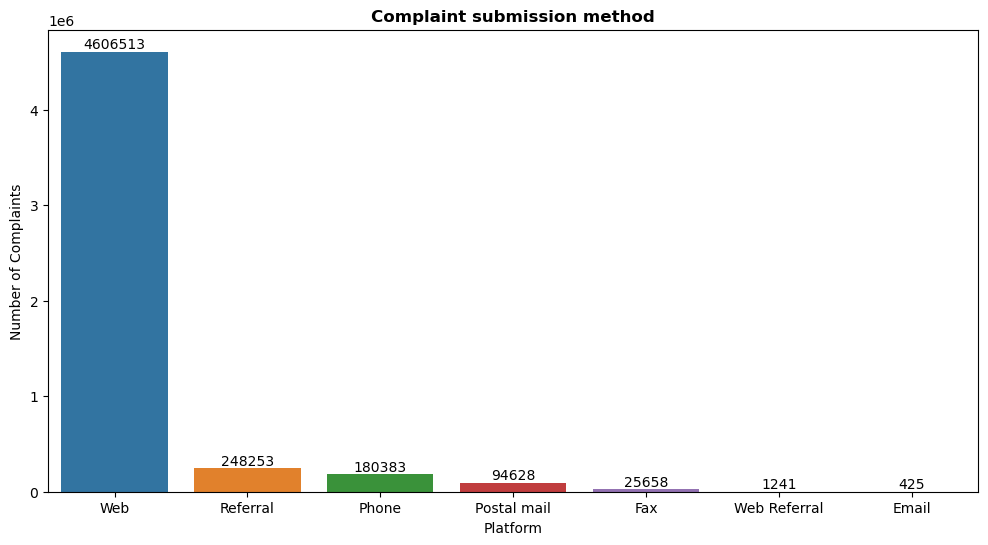

In [232]:
plt.figure(figsize = (12,6))
ax = sns.countplot(x = df['Submitted via'], order = df['Submitted via'].value_counts().index)
plt.title('Complaint submission method', fontweight = 'bold')
plt.xlabel('Platform')
plt.ylabel('Number of Complaints')
ax.bar_label(ax.containers[0], labels=[f'{x.get_height():.0f}' for x in ax.containers[0]])
plt.show()

* **Based on the plot provided, it is evident that a **majority of individuals** choose the **web** as their preferred medium for submitting complaints**

In [26]:
df['Consumer disputed'].unique()

array([nan, 'Yes', 'No'], dtype=object)

In [38]:
import datetime as dt

df['year'] = df['Date received'].dt.year

### Year and Month wise Issues

In [40]:
pd.DataFrame(df[['year', 'Issue']].groupby('year').value_counts())

count
year Issue                                                     
2011 Loan modification,collection,foreclosure               644
     Loan servicing, payments, escrow account               377
     Billing disputes                                       168
     Identity theft / Fraud / Embezzlement                  152
     Application, originator, mortgage broker               151
     APR or interest rate                                   121
     Other                                                   87
     Credit reporting                                        84
     Closing/Cancelling account                              75
     Collection practices                                    55
     Late fee                                                54
     Settlement process and costs                            54
     Credit determination                                    54
     Credit decision / Underwriting                          47
     Credit card protection / Debt protection                44
     Collection debt dispute                                 39
     Other fee                                               38
     Billing statement                                       36
     Credit line increase/decrease                           30
     Rewards                                                 29
     Payoff process                                          27
     Customer service / Customer relations                   27
     Advertising and marketing                               26
     Transaction issue                                       22
     Balance transfer                                        18
     Delinquent account                                      17
     Unsolicited issuance of credit card                     15
     Forbearance / Workout plans                              9
     Application processing delay                             9
     Privacy                                                  7
     Balance transfer fee                                     5
     Cash advance fee                                         3
     Sale of account                                          3
     Arbitration                                              2
     Bankruptcy                                               2
     Overlimit fee                                            2
     Convenience checks                                       2
     Cash advance                                             1
2012 Loan modification,collection,foreclosure             22140
     Loan servicing, payments, escrow account              9676
     Account opening, closing, or management               4945
     Deposits and withdrawals                              3479
     Application, originator, mortgage broker              2729
     Billing disputes                                      2289
     Other                                                 2107
     Problems caused by my funds being low                 2034
     Repaying your loan                                    1888
     APR or interest rate                                  1733
     Settlement process and costs                          1326
     Incorrect information on credit report                1259
     Problems when you are unable to pay                   1255
     Credit reporting                                      1156
     Making/receiving payments, sending money              1044
     Identity theft / Fraud / Embezzlement                  990
     Closing/Cancelling account                             989
     Managing the loan or lease                             962
     Credit decision / Underwriting                         849
     Using a debit or ATM card                              710
     Collection practices                                   667
     Late fee                                               632
     Credit card protection / Debt protection               583
     Collection debt dispu

In [67]:
df.Issue.value_counts()

Issue
Incorrect information on your report                                                1500632
Improper use of your report                                                          796863
Problem with a credit reporting company's investigation into an existing problem     589336
Attempts to collect debt not owed                                                    211400
Problem with a company's investigation into an existing problem                      202710
Managing an account                                                                  129082
Loan modification,collection,foreclosure                                             112306
Incorrect information on credit report                                               102684
Written notification about debt                                                       96445
Trouble during payment process                                                        81090
Loan servicing, payments, escrow account                                  

In [68]:
yearly_issues = pd.DataFrame(df.year.value_counts())

yearly_issues.rename(columns = {'count': 'Number of issues'}, inplace = True)

yearly_issues

,Number of issues
year,
2023,1292154
2022,800359
2024,650936
2021,496004
2020,444294
2019,277298
2018,257220
2017,242854
2016,191414


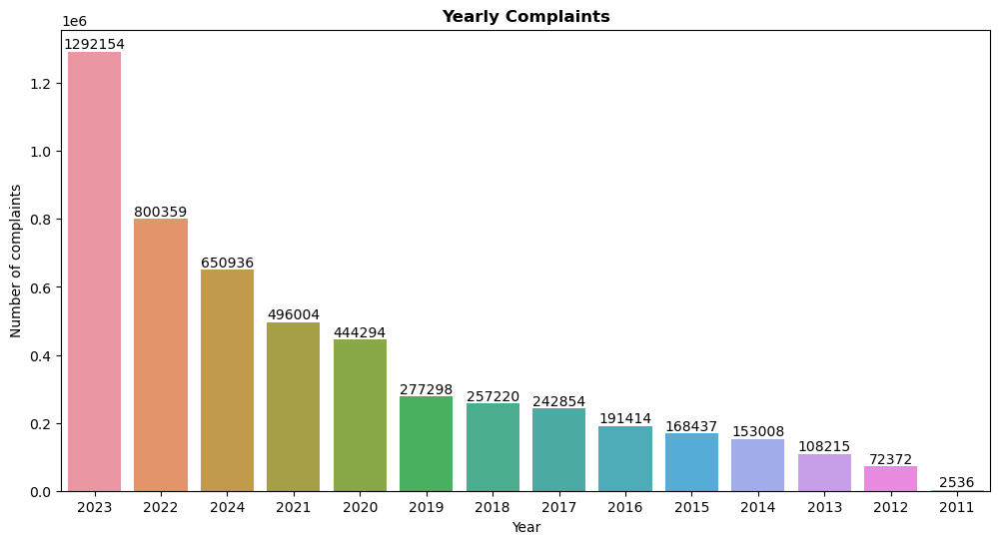

In [197]:
plt.figure(figsize = (12,6))
ax = sns.countplot(x = df.year, order = df.year.value_counts().index)
plt.title('Yearly Complaints', fontweight = 'bold')
plt.xlabel('Year')
plt.ylabel('Number of complaints')
ax.bar_label(ax.containers[0], labels=[f'{x.get_height():.0f}' for x in ax.containers[0]])
plt.show()

* **From the above graph, it is observed that complaints are increasing with each year.**

In [70]:
df['month'] = df['Date received'].dt.month

monthly_issues = pd.DataFrame(df.month.value_counts())

monthly_issues.rename(columns = {'count':'Number of issues'}, inplace = True)

monthly_issues

,Number of issues
month,
3,547966
4,528337
1,475319
2,467756
12,419965
10,406061
8,403010
9,388414
11,386523


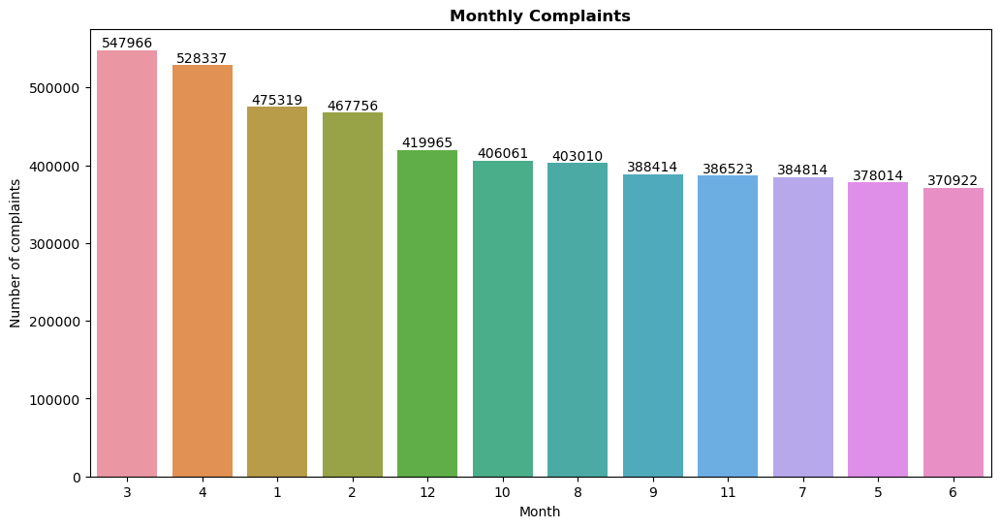

In [143]:
plt.figure(figsize = (12,6))
ax = sns.countplot(x = df.month, order = df.month.value_counts().index)
plt.title('Monthly Complaints', fontweight = 'bold')
plt.xlabel('Month')
plt.ylabel('Number of complaints')
ax.bar_label(ax.containers[0], fontweight = 8)
plt.show()

* **In the **third month**, which is **March**, we observe the **highest number of complaints**. Following March, **April** and **January** also experience significant complaint volumes. On the other hand, the **lowest number of complaints** are recorded in **June**, followed by **May** and **July**.**

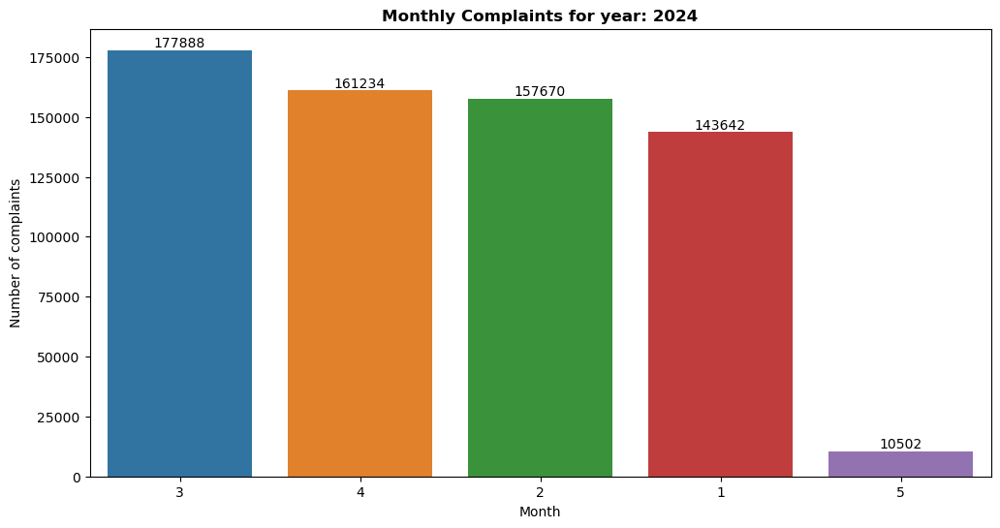

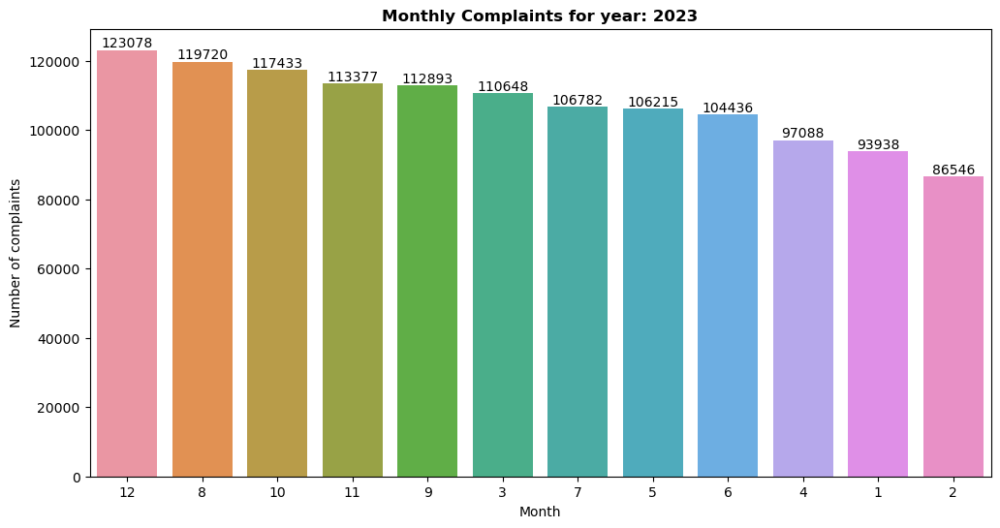

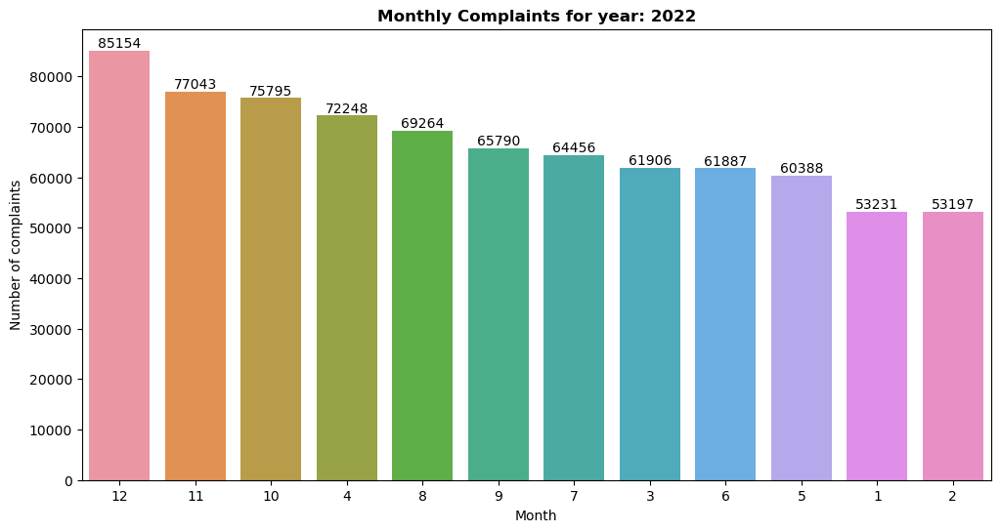

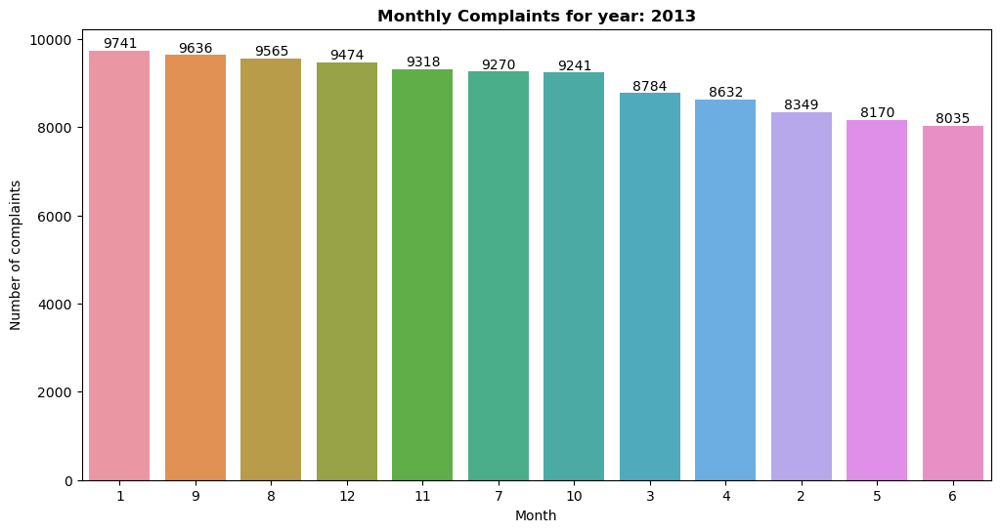

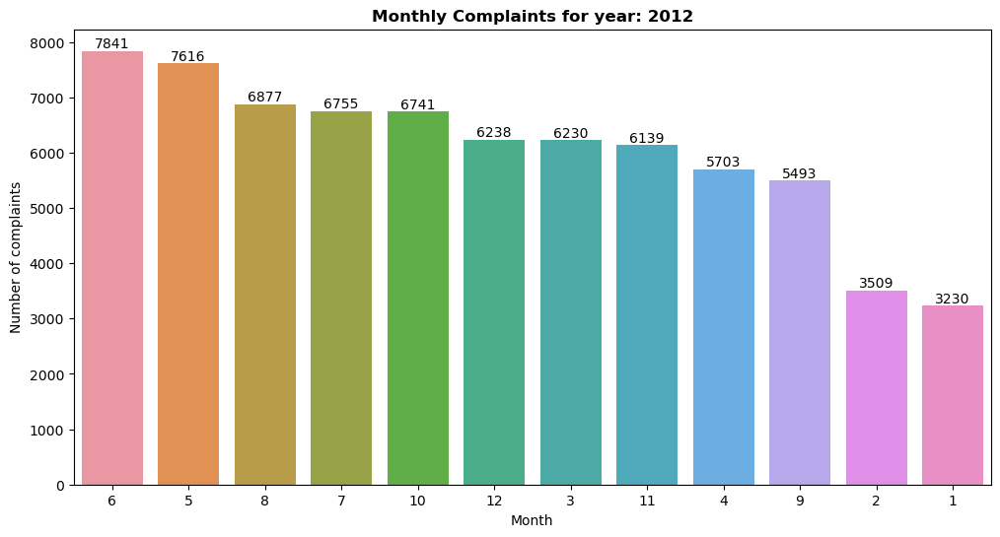

...

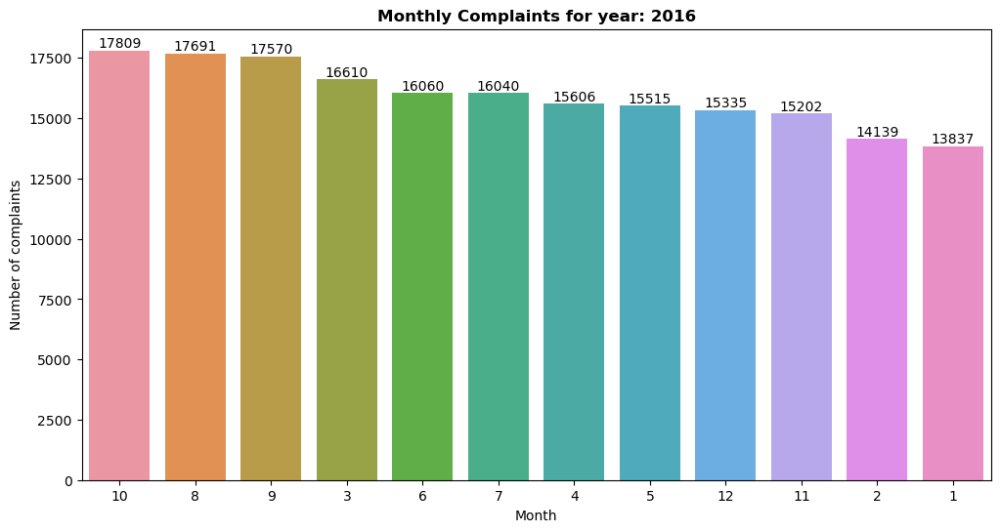

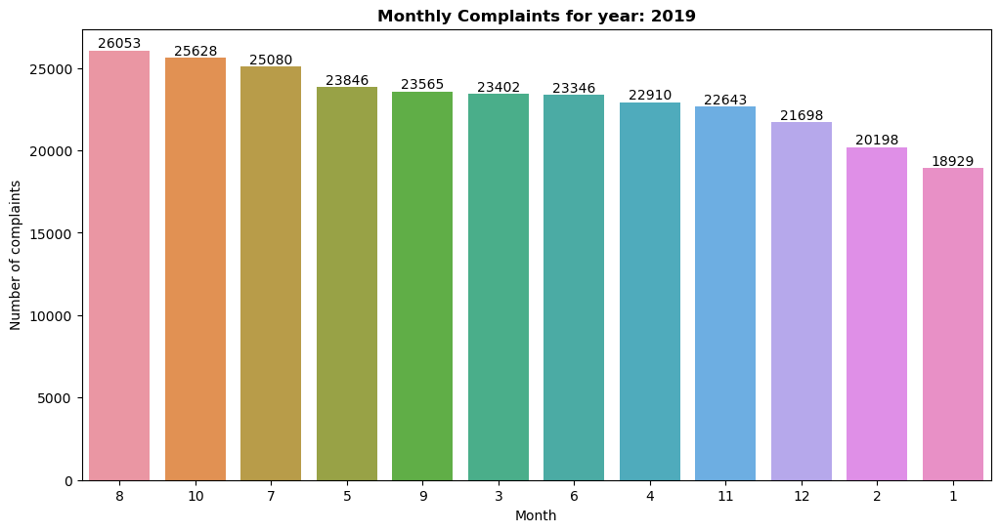

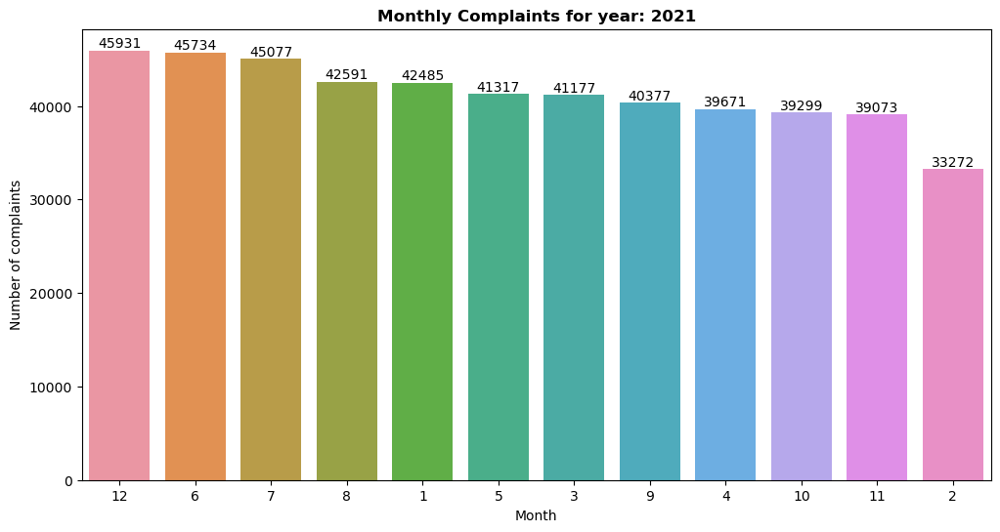

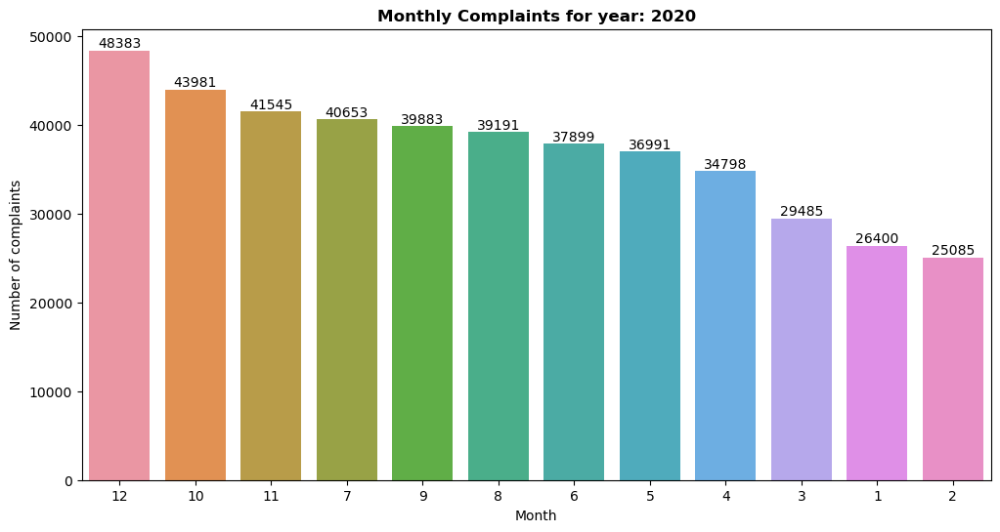

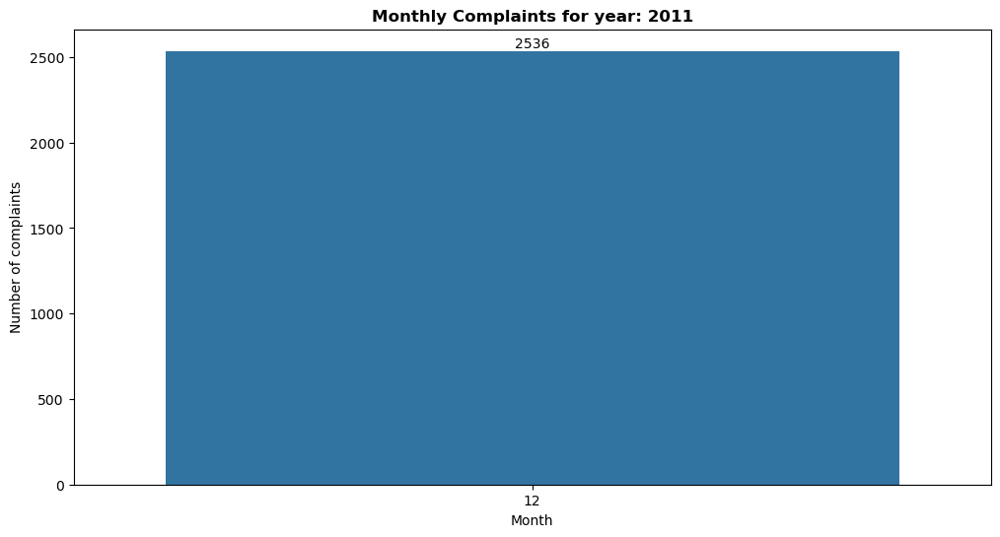

In [148]:
years = df.year.unique()

for i in years:
    plt.figure(figsize = (12,6))
    ax = sns.countplot(x = df['month'][df.year == i], order = df['month'][df.year == i].value_counts().index)
    plt.title(f'Monthly Complaints for year: {i}', fontweight = 'bold')
    plt.xlabel('Month')
    plt.ylabel('Number of complaints')
    ax.bar_label(ax.containers[0], fontweight = 8)
    plt.show()

In [76]:
pd.DataFrame(df[['year', 'month']].groupby('year').value_counts())

count
year month        
2011 12       2536
2012 6        7841
     5        7616
     8        6877
     7        6755
     10       6741
     12       6238
     3        6230
     11       6139
     4        5703
     9        5493
     2        3509
     1        3230
2013 1        9741
     9        9636
     8        9565
     12       9474
     11       9318
     7        9270
     10       9241
     3        8784
     4        8632
     2        8349
     5        8170
     6        8035
2014 3       13942
     4       13838
     7       13406
     8       13184
     2       13048
     10      12898
     1       12617
     6       12513
     9       12463
     5       12163
     12      11680
     11      11256
2015 7       15916
     8       15763
     10      14893
     6       14515
     3       14509
     9       14331
     4       13749
     5       13678
     11      12894
     12      12884
     2       12679
     1       12626
2016 10      17809
     8       17691
     9       17570
     3       16610
     6       16060
     7       16040
     4       15606
     5       15515
     12      15335
     11      15202
     2       14139
     1       13837
2017 9       27344
     8       21395
     1       21002
     10      20448
     7       20426
     3       19753
     5       19285
     12      19027
     11      18986
     6       18552
     4       18539
     2       18097
2018 4       24321
     1       23641
     3       23632
     5       22328
     2       21967
     10      21895
     8       21716
     7       20953
     6       20104
     9       19069
     11      19047
     12      18547
2019 8       26053
     10      25628
     7       25080
     5       23846
     9       23565
     3       23402
     6       23346
     4       22910
     11      22643
     12      21698
     2       20198
     1       18929
2020 12      48383
     10      43981
     11      41545
     7       40653
     9       39883
     8       39191
     6       37899
     5       36991
     4       34798
     3       29485
     1       26400
     2       25085
2021 12      45931
     6       45734
     7       45077
     8       42591
     1       42485
     5       41317
     3       41177
     9       40377
     4       39671
     10      39299
     11      39073
     2       33272
2022 12      85154
     11      77043
     10      75795
     4       72248
     8       69264
     9       65790
     7       64456
     3       61906
     6       61887
     5       60388
     1       53231
     2       53197
2023 12     123078
     8      119720
     10     117433
     11     113377
     9      112893
     3      110648
     7      106782
     5      106215
     6      104436
     4       97088
     1       93938
     2       86546
2024 3      177888
     4      161234
     2      157670
     1      143642
     5       10502

In [92]:
pd.DataFrame(df[['year','Consumer disputed']][(df['Consumer disputed'] == 'Yes') | (df['Consumer disputed'] == 'No')].groupby(['year']).value_counts())

count
year Consumer disputed        
2011 No                   1963
     Yes                   573
2012 No                  55945
     Yes                 16427
2013 No                  85621
     Yes                 22594
2014 No                 123297
     Yes                 29711
2015 No                 134154
     Yes                 34283
2016 No                 156626
     Yes                 34788
2017 No                  62332
     Yes                 10002

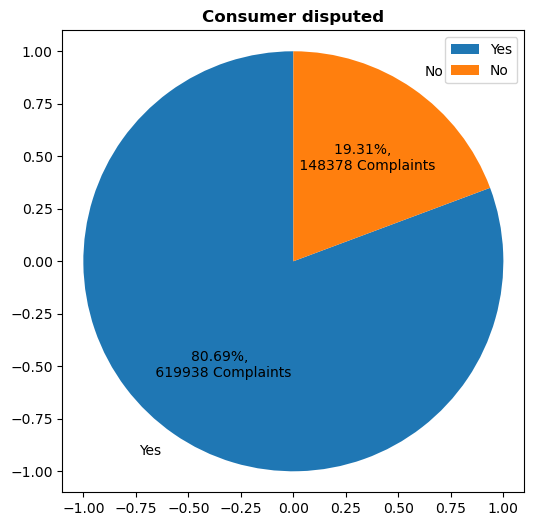

In [207]:
plt.figure(figsize = (12,6))
mylabels = ['Yes', 'No']
plt.pie(x = df['Consumer disputed'].value_counts(), frame = True, startangle = 90,
        autopct = lambda p:f"{p:.2f}%, \n {p*sum(df['Consumer disputed'].value_counts().values)/100 :.0f} Complaints",
        labels = mylabels)
plt.title('Consumer disputed', fontweight = 'bold')
plt.legend(loc = 'upper right')
plt.show()

* **From the above plot it is observed that 80% of complaints are disputed.**

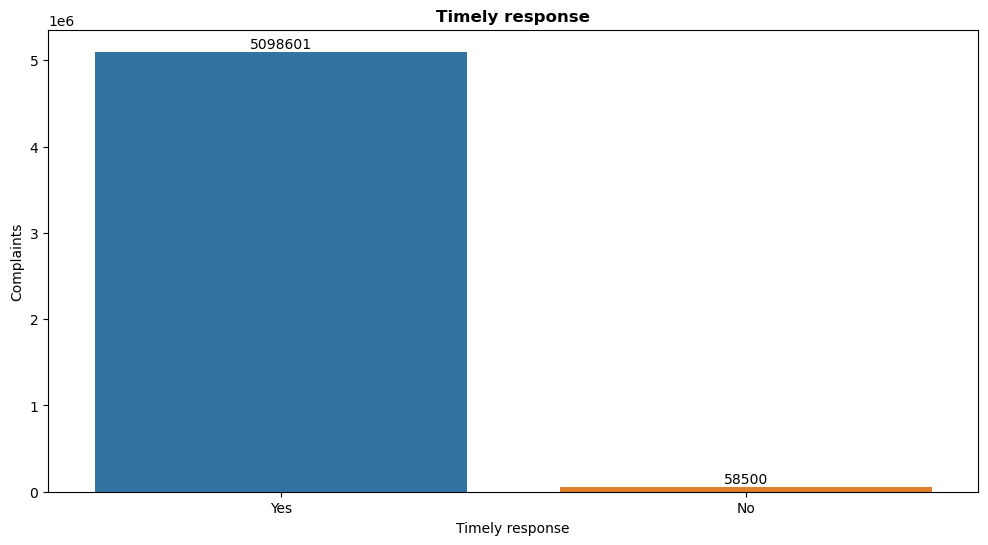

In [196]:
plt.figure(figsize = (12,6))
ax = sns.countplot(x = df['Timely response'], 
              order = df['Timely response'].value_counts().index)
plt.title('Timely response', fontweight = 'bold')
plt.ylabel('Complaints')
ax.bar_label(ax.containers[0], labels=[f'{x.get_height():.0f}' for x in ax.containers[0]])
plt.show()

* **Timely response is there for the most complaints.**

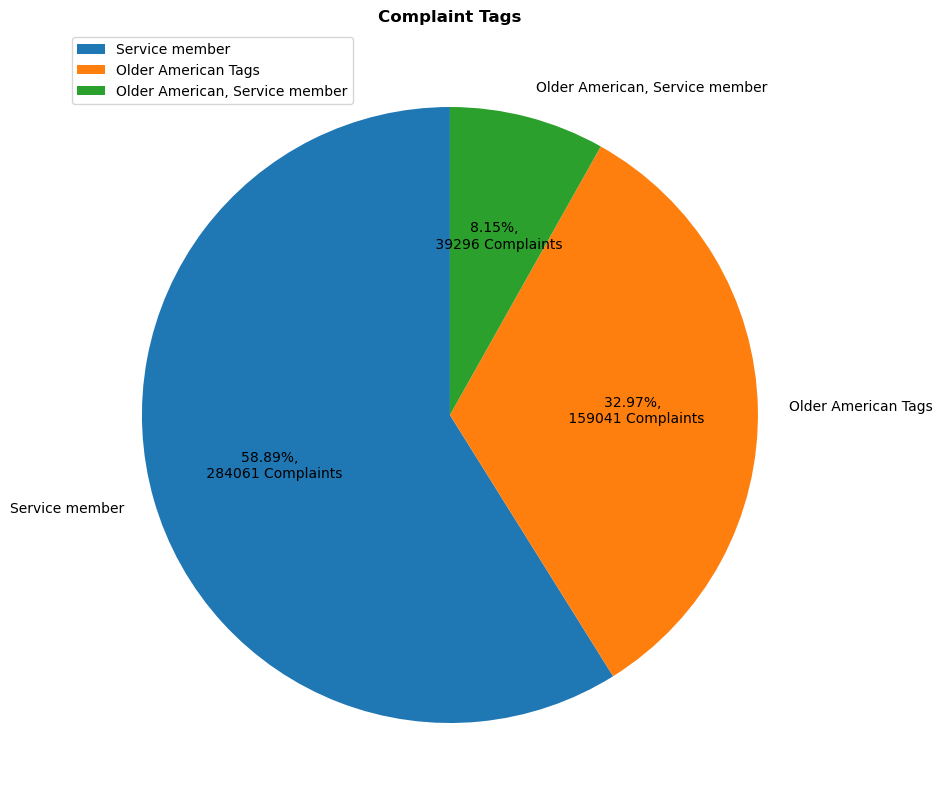

In [222]:
plt.figure(figsize = (15,10))
mylabels = ['Service member', 'Older American Tags', 'Older American, Service member']
plt.pie(x = df.Tags.value_counts(), frame = False, labels = mylabels, startangle = 90,
                   autopct = lambda p:f"{p:.2f}%, \n {p*sum(df.Tags.value_counts().values)/100 :.0f} Complaints")
plt.title('Complaint Tags', fontweight = 'bold')
plt.legend(loc = 'upper left')
plt.show()

In [124]:
pd.DataFrame(df.State.value_counts())

,count
State,
FL,617920
CA,589005
TX,549191
GA,353364
NY,331130
PA,244458
IL,215057
NJ,174306
NC,167894


### State Year wise complaints

In [153]:
pd.DataFrame(df[['State', 'year']].groupby('State').value_counts())

count
State                                year        
AA                                   2021      12
                                     2020      11
                                     2018       9
                                     2023       8
                                     2016       5
                                     2013       4
                                     2022       3
                                     2014       3
                                     2017       2
                                     2015       1
                                     2019       1
AE                                   2023     260
                                     2022     220
                                     2024      98
                                     2017      97
                                     2018      96
                                     2020      91
                                     2021      86
                                     2015      81
                                     2016      73
                                     2019      62
                                     2014      59
                                     2013      44
                                     2012      25
AK                                   2023     749
                                     2022     582
                                     2020     397
                                     2021     386
                                     2024     382
                                     2018     271
                                     2017     237
                                     2019     223
                                     2016     220
                                     2014     182
                                     2015     167
                                     2013     150
                                     2012      78
                                     2011       5
AL                                   2023   25175
                                     2022   19523
                                     2021   11729
                                     2024   11027
                                     2020   10813
                                     2019    4047
                                     2018    3146
                                     2017    3026
                                     2016    2096
                                     2015    1983
                                     2014    1557
                                     2013     977
                                     2012     583
                                     2011      18
AP                                   2022     111
                                     2023      87
                                     2017      79
                                     2018      65
                                     2024      58
                                     2019      55
                                     2015      54
                                     2021      50
                                     2014      48
                                     2020      48
                                     2016      45
                                     2013      28
                                     2012      13
AR                                   2020    7612
                                     2023    7599
                                     2022    5026
                                     2024    3135
                                     2021    2394
                                     2018    1496
                                     2019    1412
                                     2017    1254
                                     2016     812
                                     2015     763
                                     2014     688
                                     2013     452
                                     2012     264
                                     2011   

### Top 5 states with most complaints (Year wise)

In [136]:
pd.DataFrame(df[['year', 'State']].groupby('State').value_counts().nlargest())

,,count
State,year,
FL,2023,170207
TX,2023,154091
CA,2023,132864
GA,2023,98908
FL,2022,98278


### Last 5 states with least complaints (Year wise)

In [149]:
pd.DataFrame(df[['year', 'State']].groupby('State').value_counts().nsmallest())

count
State year       
AA    2015      1
      2019      1
AS    2024      1
FM    2024      1
MH    2019      1

### State, Month wise complaints

In [154]:
pd.DataFrame(df[['State', 'month']].groupby('State').value_counts())

count
State                                month       
AA                                   3         10
                                     5          9
                                     1          8
                                     2          5
                                     4          5
                                     6          5
                                     9          4
                                     12         4
                                     7          3
                                     10         2
                                     8          2
                                     11         2
AE                                   4        137
                                     2        130
                                     7        126
                                     3        125
                                     1        125
                                     9        110
                                     12       107
                                     6        101
                                     8         89
                                     10        84
                                     5         82
                                     11        76
AK                                   4        429
                                     3        421
                                     2        408
                                     1        346
                                     10       335
                                     8        332
                                     5        330
                                     6        297
                                     9        290
                                     11       289
                                     7        284
                                     12       268
AL                                   4      10229
                                     3       9529
                                     1       8827
                                     2       7931
                                     10      7768
                                     12      7736
                                     5       7475
                                     9       7473
                                     8       7471
                                     7       7468
                                     6       7032
                                     11      6761
AP                                   5         87
                                     2         80
                                     4         71
                                     3         67
                                     9         66
                                     1         63
                                     10        60
                                     12        58
                                     8         53
                                     6         50
                                     7         49
                                     11        37
AR                                   3       3628
                                     4       3541
                                     5       3186
                                     7       2961
                                     2       2849
                                     6       2838
                                     8       2776
                                     1       2546
                                     12      2243
                                     11      2202
                                     10      2139
                                     9       2007
AS                                   1          7
                                     8          6
                                     12         5
                                     7          5
                                     6          4
                                     4          4
                                     10     

### Top 5 States with most complaints (month wise)

In [150]:
pd.DataFrame(df[['month', 'State']].groupby('State').value_counts().nlargest())

count
State month       
FL    4      66123
      3      66054
CA    3      61534
TX    4      59125
CA    4      57615

### Last 5 States with least complaints (month wise) 

In [151]:
pd.DataFrame(df[['month', 'State']].groupby('State').value_counts().nsmallest())

count
State month       
AS    5          1
MH    10         1
      12         1
MP    11         1
      9          1

In [155]:
df['Consumer consent provided'].unique()

array(['Consent not provided', 'Consent provided', nan, 'Other',
       'Consent withdrawn'], dtype=object)

In [157]:
pd.DataFrame(df[['Consumer consent provided', 'Consumer disputed']].groupby('Consumer consent provided').value_counts())

count
Consumer consent provided Consumer disputed        
Consent not provided      No                 103358
                          Yes                 21949
Consent provided          No                 128228
                          Yes                 35811
Consent withdrawn         No                      7
                          Yes                     1
Other                     No                   6716
                          Yes                  1731

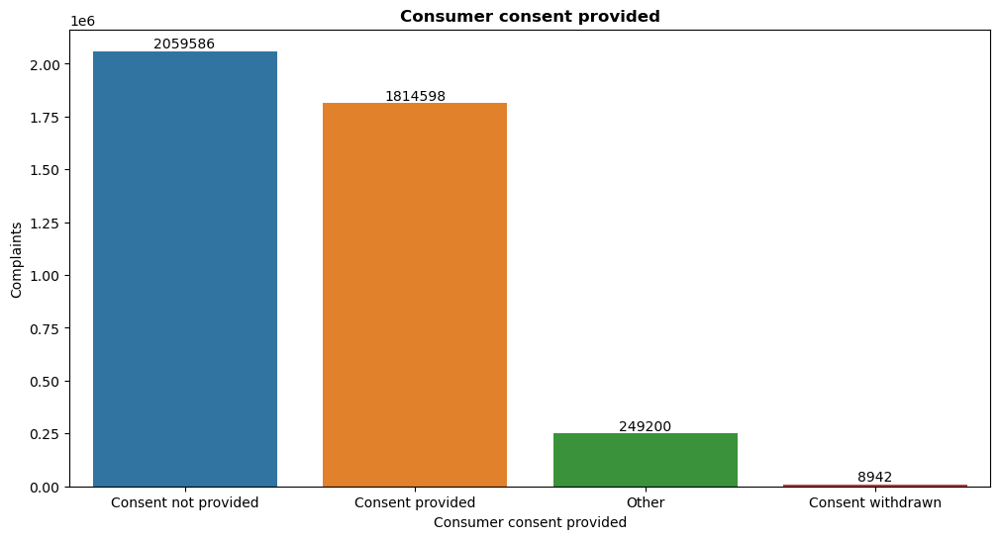

In [195]:
plt.figure(figsize = (12,6))
ax = sns.countplot(x = df['Consumer consent provided'], order = df['Consumer consent provided'].value_counts().index)
plt.title('Consumer consent provided', fontweight = 'bold')
plt.ylabel('Complaints')
ax.bar_label(ax.containers[0], labels=[f'{x.get_height():.0f}' for x in ax.containers[0]])
plt.show()

* **Based on the provided plot, it is evident that **a majority of consumers do not provide consent for their complaints**. However, there are **very few instances** where individuals have **withdrawn their consent** from the complaint process.**

In [25]:
df.columns

Index(['Date received', 'Product', 'Sub-product', 'Issue', 'Sub-issue',
       'Consumer complaint narrative', 'Company public response', 'Company',
       'State', 'ZIP code', 'Tags', 'Consumer consent provided',
       'Submitted via', 'Date sent to company', 'Company response to consumer',
       'Timely response', 'Consumer disputed', 'Complaint ID'],
      dtype='object')